---
title: "Tutorial of matching using steerers"
description: "Steerers are a way to do rotation invariant image matching without resorting to rerunning the descriptor network multiple times"
author:
    - "Georg Bökman"
date: "06-29-2024"
categories:
    - "intermediate"
    - "kornia.feature"
    - "Image matching"
image: "../tutorials/assets/steerers-tutorial-thumbnail.png"
---

<a href="https://colab.sandbox.google.com/github/kornia/tutorials/blob/master/nbs/image_matching_steerers.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in google colab"></a>
# Tutorial of matching using steerers

In this tutorial, we will go over basics of matching with DeDoDe and steerers in Kornia. This is based on the paper [Steerers: A framework for rotation equivariant keypoint descriptors](https://arxiv.org/abs/2312.02152). Steerers are rotation matrices in latent space that can be used to rotate DeDoDe (or other) descriptions without having to run the DeDoDe descriptor network multiple times. Keep in mind that DeDoDe default matchers are not yet implemented in Kornia as of the time of writing this so results may be suboptimal, but the matching seems to work well with the `smnn` matcher as well.

## Setup
We start by installing Kornia and some more dependencies. Then we download two astronaut images of the city of Madrid. (Images were found by browsing through the [Astronaut Photo Interactive Map](https://eol.jsc.nasa.gov/ExplorePhotos).) These images were taken by astrounauts on the ISS and they have a large inplane rotation between them.

In [1]:
%%capture
! pip install git+https://github.com/georg-bn/kornia.git  # to be replaced with actual Kornia once steerers are included
! pip install kornia-rs
! pip install kornia_moons --no-deps
! pip install opencv-python --upgrade

In [2]:
import cv2
import kornia as K
import kornia.feature as KF
import matplotlib.pyplot as plt
import numpy as np
import torch
from kornia.feature.adalam import AdalamFilter
from kornia_moons.viz import *

device = K.utils.get_cuda_or_mps_device_if_available()
print(device)

cuda:0


In [3]:
import io
import requests

def download_image(url: str, filename: str = "") -> str:
    filename = url.split("/")[-1] if len(filename) == 0 else filename
    # Download
    bytesio = io.BytesIO(requests.get(url).content)
    # Save file
    with open(filename, "wb") as outfile:
        outfile.write(bytesio.getbuffer())

    return filename

url_1 = "https://eol.jsc.nasa.gov/DatabaseImages/ESC/small/ISS064/ISS064-E-29641.JPG"  # change "small" to "large" for high-res images
url_2 = "https://eol.jsc.nasa.gov/DatabaseImages/ESC/small/ISS068/ISS068-E-8937.JPG"
download_image(url_1)
download_image(url_2)

fname1 = url_1.split("/")[-1]
fname2 = url_2.split("/")[-1]

img1 = K.io.load_image(fname1, K.io.ImageLoadType.RGB32, device=device)[None, ...]
img2 = K.io.load_image(fname2, K.io.ImageLoadType.RGB32, device=device)[None, ...]
print(img1.shape, img2.shape)

hw1 = torch.tensor(img1.shape[2:], device=device)
hw2 = torch.tensor(img2.shape[2:], device=device)

torch.Size([1, 3, 427, 640]) torch.Size([1, 3, 427, 640])


This image pair is in fact quite difficult for humans (at least for me). Can you find corresponding points?

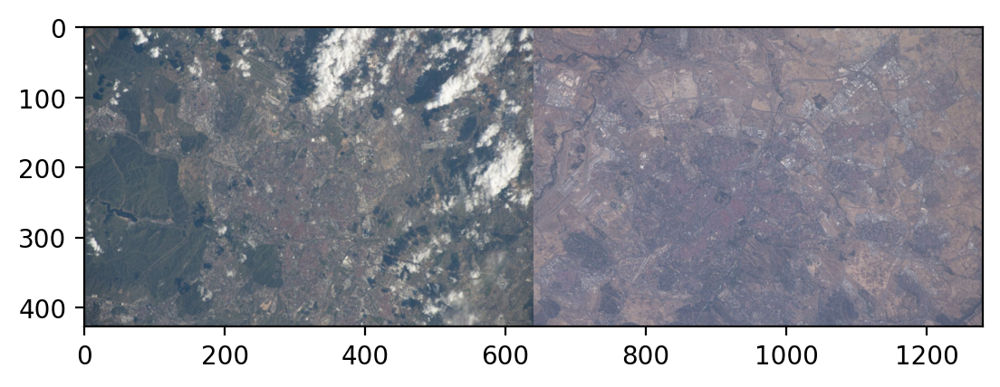

In [4]:
plt.figure(dpi=200)
plt.imshow(np.concatenate([K.tensor_to_image(img1.cpu()), K.tensor_to_image(img2.cpu())], axis=1))

## Matching
To use steerers, we create a `DiscreteSteerer`. When we want finegrained rotations, we choose a `SO2`-version and set the `steerer_order` quite high. Here, we set it to 16, meaning that we will test increments of 360/16 = 22.5 degrees.
We match using a test-time-augmentation in latent space that is implemented through `DescriptorMatcherWithSteerer`. Typically, DeDoDe works better the more keypoints are used. Here we use 5000 which is a sort of lower bound of when DeDoDe can be expected to work well.

In [5]:
dedode = KF.DeDoDe.from_pretrained(detector_weights="L-C4-v2", descriptor_weights="B-SO2").to(device)
steerer_order = 16  # discretisation order of rotation angles
steerer = KF.steerers.DiscreteSteerer.from_pretrained(generator_weights="B-SO2", steerer_order=steerer_order).to(device)
matcher = KF.matching.DescriptorMatcherWithSteerer(steerer=steerer, steerer_order=steerer_order, steer_mode="global", match_mode="smnn", th=0.98)

with torch.inference_mode():
    kps1, scores1, descs1 = dedode(img1, n=5_000)
    kps2, scores2, descs2 = dedode(img2, n=5_000)
    kps1, kps2, descs1, descs2 = kps1[0], kps2[0], descs1[0], descs2[0]
    dists, idxs, num_rot = matcher(descs1, descs2, normalize=True)

print(f"{idxs.shape[0]} tentative matches with steered DeDoDe, at rotation of {num_rot * 360 / steerer_order} degrees")

668 tentative matches with steered DeDoDe, at rotation of 67.5 degrees


We fit a homography to the matches using RANSAC to filter out outliers.

In [6]:
def get_matching_keypoints(kp1, kp2, idxs):
    mkpts1 = kp1[idxs[:, 0]]
    mkpts2 = kp2[idxs[:, 1]]
    return mkpts1, mkpts2

mkpts1, mkpts2 = get_matching_keypoints(kps1, kps2, idxs)

Hm, inliers = cv2.findHomography(
    mkpts1.detach().cpu().numpy(), mkpts2.detach().cpu().numpy(), cv2.USAC_MAGSAC, 1., 0.999, 100000
)
inliers = inliers > 0
print(f"{inliers.sum()} inliers with steered DeDoDe")

61 inliers with steered DeDoDe


Let's plot the estimated matches!

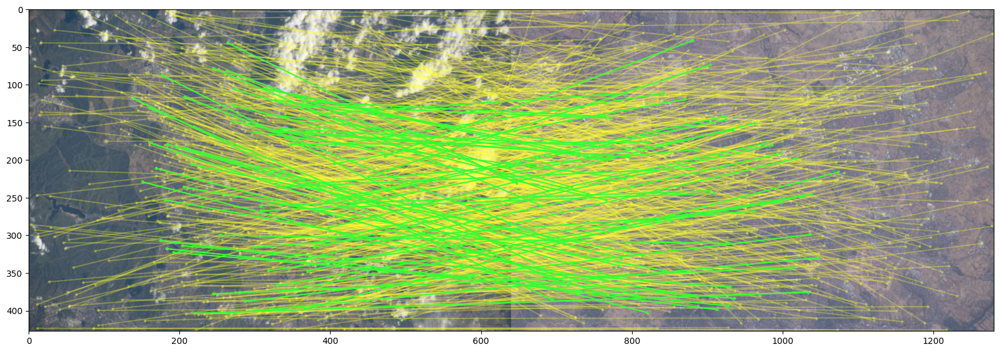

In [7]:
draw_LAF_matches(
    KF.laf_from_center_scale_ori(kps1[None].cpu()),
    KF.laf_from_center_scale_ori(kps2[None].cpu()),
    idxs.cpu(),
    K.tensor_to_image(img1.cpu()),
    K.tensor_to_image(img2.cpu()),
    inliers,
    draw_dict={"inlier_color": (0.2, 1, 0.2), "tentative_color": (1, 1, 0.2, 0.3), "feature_color": None, "vertical": False},
)

It's quite hard to see anything in the previous plot, but if we plot only the inliers we see more.

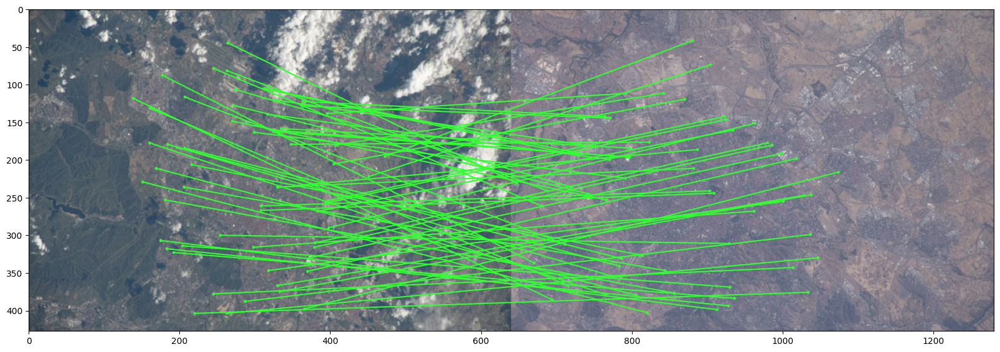

In [8]:
draw_LAF_matches(
    KF.laf_from_center_scale_ori(kps1[None].cpu()),
    KF.laf_from_center_scale_ori(kps2[None].cpu()),
    idxs[inliers[:, 0]].cpu(),
    K.tensor_to_image(img1.cpu()),
    K.tensor_to_image(img2.cpu()),
    draw_dict={"tentative_color": (0.2, 1, 0.2), "feature_color": None, "vertical": False},
)

We can also visualize how good the estimated homography is. This is done through interpolating between the second image and the first image warped by the homography.

In [9]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

img1_nontensor = K.tensor_to_image(img1)
img1_warp = cv2.warpPerspective(img1_nontensor, Hm, img1_nontensor.shape[:2][::-1], borderValue=(1,1,1))
img2_nontensor = K.tensor_to_image(img2)

fig, ax = plt.subplots()
im = ax.imshow(img2_nontensor, animated=True)

def animate(frame):
    t = frame / 30

    img = img2_nontensor * (1 - t) + img1_warp * t
    im.set_array(img)
    return [im]

anim = FuncAnimation(fig, animate, frames=30, interval=100, blit=True)

plt.close(fig)
HTML(anim.to_jshtml())



Setting the animation to `Reflect` gives a nice visualization. Clearly the homography isn't perfect, but quite good. I find it especially fascinating to look at the river at the top left which is occluded by a cloud in the first (greener) image. Higher resolution images and more keypoints will improve the result here.

## Ordinary DeDoDe
How bad does ordinary DeDoDe fail on this image pair? Very badly! See below.

In [10]:
dedode = KF.DeDoDe.from_pretrained(detector_weights="L-C4-v2", descriptor_weights="B-upright").to(device)

with torch.inference_mode():
    kps1, scores1, descs1 = dedode(img1, n=5_000)
    kps2, scores2, descs2 = dedode(img2, n=5_000)
    kps1, kps2, descs1, descs2 = kps1[0], kps2[0], descs1[0], descs2[0]
    descs1 = torch.nn.functional.normalize(descs1, dim=-1)
    descs2 = torch.nn.functional.normalize(descs2, dim=-1)
    dists, idxs = KF.match_smnn(descs1, descs2, 0.98)

print(f"{idxs.shape[0]} tentative matches with DeDoDe")

mkpts1, mkpts2 = get_matching_keypoints(kps1, kps2, idxs)

Hm, inliers = cv2.findHomography(
    mkpts1.detach().cpu().numpy(), mkpts2.detach().cpu().numpy(), cv2.USAC_MAGSAC, 1.0, 0.999, 100000
)
inliers = inliers > 0
print(f"{inliers.sum()} inliers with DeDoDe")

391 tentative matches with DeDoDe
5 inliers with DeDoDe


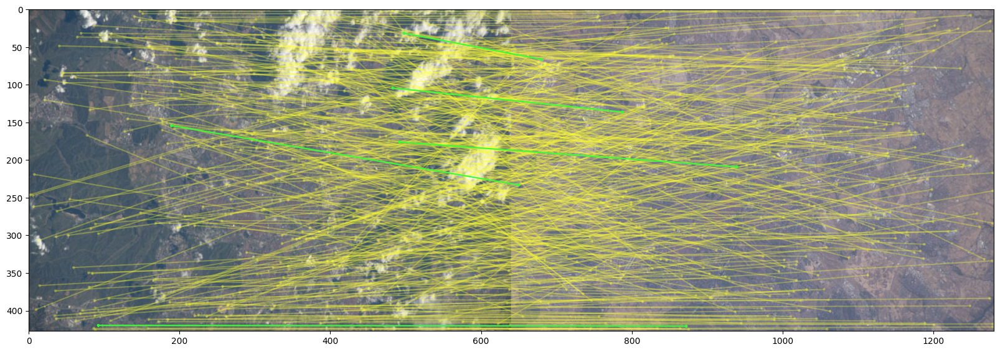

In [11]:
draw_LAF_matches(
    KF.laf_from_center_scale_ori(kps1[None].cpu()),
    KF.laf_from_center_scale_ori(kps2[None].cpu()),
    idxs.cpu(),
    K.tensor_to_image(img1.cpu()),
    K.tensor_to_image(img2.cpu()),
    inliers,
    draw_dict={"inlier_color": (0.2, 1, 0.2), "tentative_color": (1, 1, 0.2, 0.3), "feature_color": None, "vertical": False},
)

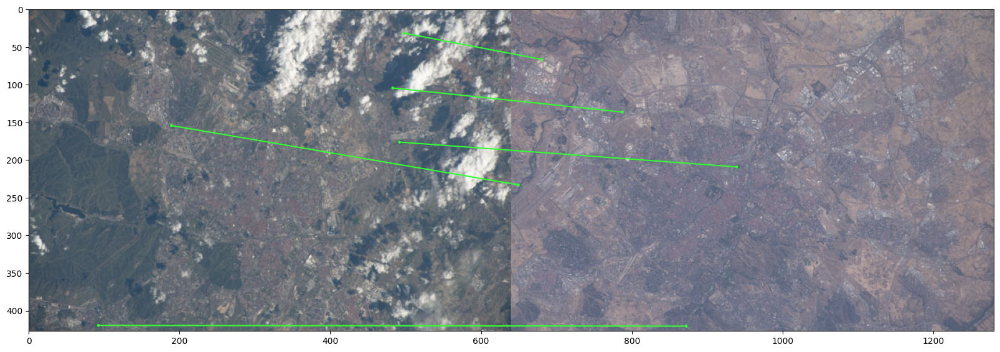

In [12]:
draw_LAF_matches(
    KF.laf_from_center_scale_ori(kps1[None].cpu()),
    KF.laf_from_center_scale_ori(kps2[None].cpu()),
    idxs[inliers[:, 0]].cpu(),
    K.tensor_to_image(img1.cpu()),
    K.tensor_to_image(img2.cpu()),
    draw_dict={"tentative_color": (0.2, 1, 0.2), "feature_color": None, "vertical": False},
)